In [3]:
import pandas as pd
import numpy as np
import folium

from gnact import utils, clust, network
import db_config

from sklearn.cluster import DBSCAN

import warnings
warnings.filterwarnings('ignore')

# create the engine to the database
engine = utils.connect_engine(db_config.colone_cargo_params, print_verbose=True)

Creating Engine...
Engine created for ais_cargo
PostgreSQL 12.3 on x86_64-pc-linux-gnu, compiled by gcc (GCC) 4.8.5 20150623 (Red Hat 4.8.5-39), 64-bit


## Demonstration of Plotting and Density Based Clustering Methods

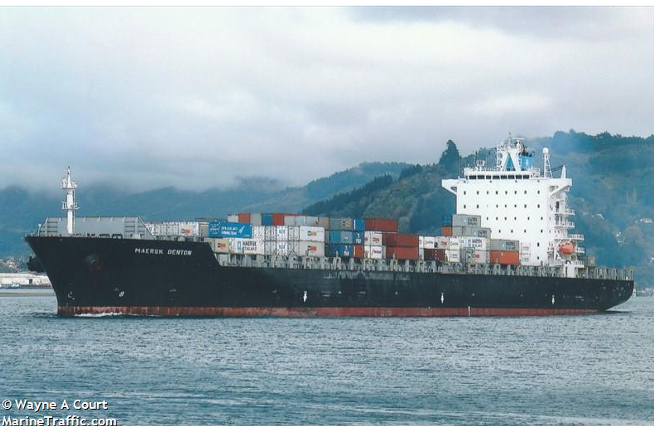

Reducing dense, geospatial datasets to starts and stops of indvidual selectors challenges conventional GIS techniques.  In the following examples, we will use ship position data from AIS to track the MSC ARUSHI (MMSI:636016432) during its voyages in 2017.  We'll look over several different density based clustering methods, static trip segmentation based on known sites, and an implementation of dynamic trip segmentation from Scikit-Mobility.

### Plot of Raw Data

In [29]:
# make the df from the data in the database for MSC Ashrui
df_posits = clust.get_uid_posits(('636016432',), engine, end_time='2018-01-01')
df_posits.head()

,id,lat,lon,time
0,15867231,42.28535,-69.12919,2017-01-06 07:04:31
1,15867232,42.28576,-69.14447,2017-01-06 07:06:31
2,15867550,42.28601,-69.15519,2017-01-06 07:07:55
3,15867549,42.28627,-69.16453,2017-01-06 07:09:08
4,15867237,42.28669,-69.17284,2017-01-06 07:10:13


In [30]:
# plot with Folium
m = folium.Map(location=[df_posits.lat.median(), df_posits.lon.median()],
               zoom_start=4, tiles='OpenStreetMap')
points = list(zip(df_posits.lat, df_posits.lon))
folium.PolyLine(points).add_to(m)
m

In [6]:
df_sites = clust.get_sites_wpi(engine)
df_sites.head()

,site_id,site_name,lat,lon,region
0,61090,SHAKOTAN,43.866667,146.833333,None
1,61110,MOMBETSU KO,44.350000,143.350000,None
2,61120,ABASHIRI KO,44.016667,144.283333,None
3,61130,NEMURO KO,43.333333,145.583333,None
4,61140,HANASAKI KO,43.283333,145.583333,None


In [12]:
df_sites = pd.read_csv('Port_Facilities.csv')
df_sites = df_sites[['id', 'nav_unit_n', 'latitude11', 'longitude1']]
df_sites.columns = ['site_id', 'site_name', 'lat', 'lon']
print(len(df_sites))
print(len(df_sites.drop_duplicates(['lat','lon'], keep='first')))

df_sites = df_sites.drop_duplicates(['lat','lon'], keep='first')
df_sites['region'] = 'us_ports'

24117
19203


In [7]:
east_coast = df_sites[(df_sites.region=='East_Coast')| (df_sites.region=='Gulf_Carrib')]
clust.plot_sites(east_coast)

Plotted 489 total sites.


### Identification and addition of ports not included in the original dataset
Our dataset is not perfect and the ship frequently goes to ports near Boston, Newark, and Savannah not in the dataset.  Therefore, we will add them here.

In [8]:
boston_site = {'site_id':1, 'site_name': 'BOSTON_MANUAL_1', 'lat': 42.342124, 'lon':-71.018312, 
               'region':'East_Coast'}
newark_site = {'site_id':2, 'site_name': 'NEWARK_MANUAL_1', 'lat': 40.682164, 'lon':-74.148607, 
               'region':'East_Coast'}
savannah_site = {'site_id':3, 'site_name': 'SAVANNAH_MANUAL_1', 'lat': 32.121167, 'lon':-81.130085, 
               'region':'East_Coast'}


df_sites = (df_sites
.append(newark_site, ignore_index=True) # add Newark
.append(boston_site, ignore_index=True) # add Boston
.append(savannah_site, ignore_index=True))

In [9]:
clust.plot_sites(east_coast.iloc[-3:])

Plotted 3 total sites.


### Calculate Nearest Site for Each Position
This will be used to evaluate the accuracy of each clustering method/hyperparameter set.  The rationale is that if there are a certain number of minimum points from the original data within a certain distance threshold from a known site, there should be a cluster identified within that same certain distance at that site.

We will calculate precision, recall, and the F1 Measure.  The precision will be the number of true positives (total number of sites where clusters ar found) divided by total number of clusters found by this method.  Recall will be the number of true positives found by the method divided by the number of sites where the original data was close by.

In [31]:
df_nn = clust.calc_nn(df_posits, df_sites)
df_nn.head()

,id,nearest_site_id,dist_km
0,15867231,11822,97.81
1,15867232,11822,96.37
2,15867550,11822,95.36
3,15867549,11822,94.49
4,15867237,11822,93.73


## Static Trip Segmentation
We will generate clusters for all positions that spend a minimum amount of time with a certain distance of any site.  This is startic trip segmentation, and will have the lowest false positive rate of any method group because all positions clustered must be within a certain distance of a known port.

This method will work great for finding ports we know, but cannot find ports beyond the distance threshold of known ports.  Despite this limitation, it is an excellent resource for evaluating precision and recall.  We can determine how many ports were found with this method, and then compute precision, recall, and F1 score for other methods.

In [32]:
df_edgelist = network.calc_edgelist(df_posits, df_nn, dist_km=3, loiter_time_mins=420)
df_nearby_activity = network.calc_nearby_activity(df_edgelist, df_sites)

m = clust.plot_sites(df_nearby_activity)
points = list(zip(df_posits.lat, df_posits.lon))
folium.PolyLine(points).add_to(m)
m

Plotted 20 total sites.


In [33]:
df_nearby_activity_cleaned = df_nearby_activity 

In [98]:
df_nearby_activity_cleaned = (df_nearby_activity 
                              .drop(index=2975, axis=1) # drop Deepwater,
                              .drop(index=2958, axis=1) # Port Richmond SI
                              .drop(index=3022, axis=1)) # Actual Savannah
                              
df_nearby_activity_cleaned

,site_id,site_name,lat,lon,region
2980,8120,GLOUCESTER,39.900000,-75.133333,East_Coast
3130,9985,FREEPORT,26.516667,-78.783333,Gulf_Carrib
3616,2,NEWARK_MANUAL_1,40.682164,-74.148607,East_Coast
3617,1,BOSTON_MANUAL_1,42.342124,-71.018312,East_Coast
3618,3,SAVANNAH_MANUAL_1,32.121167,-81.130085,East_Coast
3619,2,NEWARK_MANUAL_1,40.682164,-74.148607,East_Coast
3620,1,BOSTON_MANUAL_1,42.342124,-71.018312,East_Coast
3621,3,SAVANNAH_MANUAL_1,32.121167,-81.130085,East_Coast


In [34]:
m = clust.plot_sites(df_nearby_activity_cleaned)
points = list(zip(df_posits.lat, df_posits.lon))
folium.PolyLine(points).add_to(m)
m

Plotted 20 total sites.


### Plot of DBSCAN with Low Parameters
Lower thresholds will lead to higher recall but lower precision.

In [35]:
df_clusts = clust.calc_clusts(df_posits, eps_km=1, min_samp=50, method='dbscan')
df_centers = clust.calc_centers(df_clusts)
df_stats = clust.calc_stats(df_clusts, df_sites, df_nearby_activity_cleaned)
clust.plot_clusters(df_posits, df_centers)

Precision: 0.1667, Recall: 0.2381, F1: 0.1961
Plotted 14 total clusters.


### Plot of DBSCAN with High Parameters

In [36]:
df_clusts = clust.calc_clusts(df_posits, eps_km=3, min_samp=2000, method='dbscan')
df_centers = clust.calc_centers(df_clusts)
df_stats = clust.calc_stats(df_clusts, df_sites, df_nearby_activity_cleaned)
clust.plot_clusters(df_posits, df_centers)

Precision: 0.15, Recall: 0.15, F1: 0.15
Plotted 3 total clusters.


### DBSCAN with Tuned Parameters

In [37]:
df_clusts = clust.calc_clusts(df_posits, eps_km=1, min_samp=250, method='dbscan')
df_centers = clust.calc_centers(df_clusts)

df_stats = clust.calc_stats(df_clusts, df_sites, df_nearby_activity_cleaned)
clust.plot_clusters(df_posits, df_centers)

Precision: 0.2727, Recall: 0.2857, F1: 0.2791
Plotted 7 total clusters.


## DBSCAN With Speed Filter

In [38]:
df_traj_enhanced = clust.traj_enhance_df(df_posits)
df_slow_posits = df_traj_enhanced[df_traj_enhanced['speed_kts'] < 1]

df_clusts = clust.calc_clusts(df_slow_posits, eps_km=2, min_samp=50, method='dbscan')
df_centers = clust.calc_centers(df_clusts)
df_stats = clust.calc_stats(df_clusts, df_sites, df_nearby_activity_cleaned)
clust.plot_clusters(df_posits, df_centers)

Precision: 0.2174, Recall: 0.25, F1: 0.2326
Plotted 8 total clusters.


### OPTICS with Tuned Parameters

In [40]:
df_clusts = clust.calc_clusts(df_posits, eps_km=5, min_samp=200, method='optics')
df_centers = clust.calc_centers(df_clusts)

df_stats = clust.calc_stats(df_clusts, df_sites, df_nearby_activity_cleaned)
clust.plot_clusters(df_posits, df_centers)

Precision: 0.5789, Recall: 0.6286, F1: 0.6027
Plotted 25 total clusters.


## HDBSCAN

In [41]:
df_clusts = clust.calc_clusts(df_posits, min_samp=1500, method='hdbscan')
df_centers = clust.calc_centers(df_clusts)

df_stats = clust.calc_stats(df_clusts, df_sites, df_nearby_activity_cleaned)
clust.plot_clusters(df_posits, df_centers)

Precision: 0.6049, Recall: 0.7424, F1: 0.6667
Plotted 64 total clusters.


## ST_DBSCAN with Tuned Parameters

In [19]:
# Processing is upwards of an hour...
#df_clusts = stdbscan.ST_DBSCAN(df_posits, spatial_threshold=3, temporal_threshold=600, min_neighbors=100)
#df_clusts.to_csv('../st_dbscan_results.csv', index=False)

In [20]:
df_clusts = pd.read_csv('../st_dbscan_results.csv', parse_dates=['time'])
df_clusts = df_clusts[df_clusts['clust_id'] != -1]
df_centers = clust.calc_centers(df_clusts)

df_stats = clust.calc_stats(df_clusts, df_sites, df_nearby_activity_cleaned)
clust.plot_clusters(df_posits, df_centers)

Precision: 0.75, Recall: 0.931, F1: 0.8308
Plotted 34 total clusters.


### Experimentation with Double Clustering Approaches

In [101]:
#df_clusts = clust.calc_clusts(df_posits, eps_km=3, min_samp=100, method='dbscan')
df_clusts = clust.calc_clusts(df_posits, eps_km=5, min_samp=200, method='optics')

# need new unique cluster ids across each uid.
clust_count = 0
# will hold results of second round temporal clustering
df_second_round = pd.DataFrame()

# begin iteration.  Look at each cluster in turn from first round results and cluster across time
clusters = df_clusts['clust_id'].unique()
for c in clusters:
    df_c = df_clusts[df_clusts['clust_id'] == c]
    X = ((df_c['time'].astype('int').values) / ((10**9)*60)).reshape(-1,1) #converts time to mins
    x_id = df_c.loc[:, 'id'].astype('int').values
    # cluster again using DBSCAN with a temportal epsilon (minutes) in one dimension
    dbscan = DBSCAN(eps=600, min_samples=100, algorithm='kd_tree',
                    metric='euclidean', n_jobs=1)
    dbscan.fit(X)
    results2_dict = {'id': x_id, 'clust_id': dbscan.labels_}
    # gather the output as a dataframe
    df_clusts2 = pd.DataFrame(results2_dict)
    df_clusts2 = df_clusts2[df_clusts2['clust_id'] != -1]
    clusters2 = df_clusts2['clust_id'].unique()
    for c2 in clusters2:
        df_c2 = df_clusts2[df_clusts2['clust_id'] == int(c2)] # need int rather than numpy.int64
        # need to assign a new cluster id
        df_c2['clust_id'] = clust_count
        df_second_round = df_second_round.append(df_c2)
        clust_count +=1

df_second_results = pd.merge(df_second_round, df_clusts.drop('clust_id', axis=1), how='left', left_on='id', right_on='id')
df_centers = clust.calc_centers(df_second_results)
clust.plot_clusters(df_posits, df_centers)

df_stats = clust.calc_stats(df_second_results, df_sites, df_nearby_activity_cleaned)
clust.plot_clusters(df_posits, df_centers)

Plotted 31 total clusters.
Precision: 0.9184, Recall: 0.9783, F1: 0.9474
Plotted 31 total clusters.


## Dynamic Segmentation of Trips

Scikit-Mobility provides additional plotting and packaging tools to parse a geospatial dataset into "trips" based on "stops" along each UID's path.

In [22]:
import skmob

In [23]:
#df_posits = clust.get_uid_posits(('636016432',), engine, end_time='2018-01-01')
#df_posits['uid'] = '636016432'
tdf = skmob.TrajDataFrame(df_posits, latitude='lat', longitude='lon', datetime='time')
tdf.plot_trajectory(tiles='OpenStreetMap', zoom=4)

## SKMOB has a "stop detection" algorithm to identify stops based on distance, duration, max speed, and includes an escape clause when there is a gap in data.

In [24]:
from skmob.preprocessing import detection
stdf = detection.stops(tdf, minutes_for_a_stop=360, spatial_radius_km=2, leaving_time=True, 
                       no_data_for_minutes=360, min_speed_kmh=70)

print('Points of the original trajectory:\t%s'%len(tdf))
print('Points of stops:\t\t\t%s'%len(stdf))

m = stdf.plot_trajectory(max_users=1, start_end_markers=False, tiles='OpenStreetMap', zoom=4)
stdf.plot_stops(max_users=1, map_f=m)


Points of the original trajectory:	88655
Points of stops:			48


In [25]:
stdf.head()

,id,lat,lng,datetime,time_rounded,time_diff,time_diff_hours,cog,dist_nm,speed_kts,leaving_datetime
0,5265631,29.68072,-95.00220,2017-01-01 00:02:00,2017-01-01 18:51:00,00:01:00,0.016667,107.70,0.140196,8.411779,2017-01-01 18:52:00
1,8512630,30.17607,-85.72997,2017-01-10 19:59:00,2017-01-11 06:11:00,00:01:00,0.016667,148.49,0.249345,14.960730,2017-01-11 06:12:00
2,6423872,29.68078,-95.00178,2017-01-13 00:30:00,2017-01-15 17:25:00,00:01:00,0.016667,161.35,0.218654,13.119232,2017-01-15 17:26:00
3,9105039,30.17607,-85.72988,2017-01-20 16:05:00,2017-01-21 02:09:00,00:01:00,0.016667,130.36,0.256873,15.412359,2017-01-21 02:10:00
4,9457145,21.34503,-89.67569,2017-01-25 04:33:00,2017-01-25 23:39:00,00:38:00,0.633333,266.15,0.626169,0.988688,2017-01-25 23:54:00


### We can then use DBSCAN to cluster the stops to find "destinations" frequently visited.

In [26]:
from skmob.preprocessing import detection, clustering
cstdf = clustering.cluster(stdf, cluster_radius_km=1, min_samples=1)
cstdf.head()

,id,lat,lng,datetime,time_rounded,time_diff,time_diff_hours,cog,dist_nm,speed_kts,leaving_datetime,cluster
0,5265631,29.68072,-95.00220,2017-01-01 00:02:00,2017-01-01 18:51:00,00:01:00,0.016667,107.70,0.140196,8.411779,2017-01-01 18:52:00,4
1,8512630,30.17607,-85.72997,2017-01-10 19:59:00,2017-01-11 06:11:00,00:01:00,0.016667,148.49,0.249345,14.960730,2017-01-11 06:12:00,0
2,6423872,29.68078,-95.00178,2017-01-13 00:30:00,2017-01-15 17:25:00,00:01:00,0.016667,161.35,0.218654,13.119232,2017-01-15 17:26:00,4
3,9105039,30.17607,-85.72988,2017-01-20 16:05:00,2017-01-21 02:09:00,00:01:00,0.016667,130.36,0.256873,15.412359,2017-01-21 02:10:00,0
4,9457145,21.34503,-89.67569,2017-01-25 04:33:00,2017-01-25 23:39:00,00:38:00,0.633333,266.15,0.626169,0.988688,2017-01-25 23:54:00,3


In [27]:
m = cstdf.plot_trajectory(max_users=1, start_end_markers=False, tiles='OpenStreetMap', zoom=4)
cstdf.plot_stops(max_users=1, map_f=m)

### Now we can add it to our existing function wrappers and determine the statistics

In [28]:
df_clusts = clust.calc_clusts(df_posits, eps_km=3, eps_time=360, method='dynamic_segmentation')
df_centers = clust.calc_centers(df_clusts)
df_stats = clust.calc_stats(df_clusts, df_sites, df_nearby_activity_cleaned)
clust.plot_clusters(df_posits, df_centers)

Precision: 0.7667, Recall: 0.7931, F1: 0.7797
Plotted 48 total clusters.
